<a href="https://colab.research.google.com/github/oscarkardon/AWSAuction/blob/main/project3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Project 3
## Oscar Kardon
## Social Network Analysis of FEC committee to candidate contributions

"The FEC has jurisdiction over the financing of campaigns for the U.S. House, Senate, Presidency and the Vice Presidency."
The data for this project is from the FEC's bulk data which includes Congress, the primary subject of this project.
https://www.fec.gov/about/mission-and-history/


Reads in the 2023-2024 dataset "Contributions from candidates to candidates & independent expenditures" from FEC's bulk data: https://www.fec.gov/data/browse-data/?tab=bulk-data.

In [ ]:
import pandas as pd
headers = pd.read_csv('https://drive.google.com/uc?export=download&id=1PPSOFS-wKMAbICYJBKbx80ueWworxSbE')
df = pd.read_csv('https://drive.google.com/uc?export=download&id=1ZlU-ZkrquHffjHt0b-jVH_XiJ3SyLbFl', sep="|")
df.columns = headers.columns

<ipython-input-99-1cf66cbfec7d>:3: DtypeWarning: Columns (11,12) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('https://drive.google.com/uc?export=download&id=1ZlU-ZkrquHffjHt0b-jVH_XiJ3SyLbFl', sep="|")


Drops unhelpful columns.

In [ ]:
df = df.drop(['AMNDT_IND', 'RPT_TP', 'IMAGE_NUM', 'TRANSACTION_TP', 'OTHER_ID', 'TRAN_ID', 'FILE_NUM', 'MEMO_CD', 'MEMO_TEXT', 'SUB_ID', 'CITY', 'STATE', 'ZIP_CODE', 'EMPLOYER', 'OCCUPATION', 'TRANSACTION_DT', 'ENTITY_TP'], axis=1)

*   CMTE_ID = id of the contibutor
*   TRANSACTION_PGI = election cycle of the donation
*   NAME = committee name of the contributor
*   TRANSACTION_AMT	= contribution amount in USD
*   CAND_ID	= id of the candidate receiving the contribution






In [ ]:
df.head()

,CMTE_ID,TRANSACTION_PGI,NAME,TRANSACTION_AMT,CAND_ID
0,C00777706,P2024,JOHN CARTER FOR CONGRESS,2500,H2TX31044
1,C00777706,P2024,PETE SESSIONS FOR CONGRESS,2948,H2TX03126
2,C00777706,P2026,CAPITO FOR WEST VIRGINIA,-5000,S4WV00159
3,C00777706,P2026,CAPITO FOR WEST VIRGINIA,5000,S4WV00159
4,C00333104,P2024,FRIENDS OF DAVID SCHWEIKERT,5000,H4AZ06045


Reads in the 2023-2024 dataset "Candidate Master" from FEC's bulk data: https://www.fec.gov/data/browse-data/?tab=bulk-data. This dataset provides more detailed information on the candidate committee, most importantly the candidate name (CAND_NAME) and party (CAND_PTY_AFFILIATION)


In [ ]:
candidate_headers = pd.read_csv('https://drive.google.com/uc?export=download&id=1MCNJ_75i5dlEz9-nT-_ZI9WGZH8_YhGX')
candidates = pd.read_csv('https://drive.google.com/uc?export=download&id=1smqwpy53AH7C5hcgB5t_4YPKjFZT4Ezs', sep="|")
candidates.columns = candidate_headers.columns

In [ ]:
candidates = candidates.drop(['CAND_STATUS', 'CAND_OFFICE_DISTRICT', 'CAND_ST1', 'CAND_ST2', 'CAND_CITY', 'CAND_ST', 'CAND_ZIP', 'CAND_PCC'], axis=1)

In [ ]:
candidates.head()

,CAND_ID,CAND_NAME,CAND_PTY_AFFILIATION,CAND_ELECTION_YR,CAND_OFFICE_ST,CAND_OFFICE,CAND_ICI
0,H0AL01055,"CARL, JERRY LEE, JR",REP,2024,AL,H,I
1,H0AL01097,"AVERHART, JAMES",DEM,2024,AL,H,C
2,H0AL02087,"ROBY, MARTHA",REP,2020,AL,H,I
3,H0AL02137,"DISMUKES, WILL",REP,2020,AL,H,O
4,H0AL02160,"BROWN, THOMAS WILLIAM JR.",REP,2020,AL,H,O


Fills any potentially null values.

In [ ]:
df['CAND_ID'].fillna('null', inplace=True)

Sets CAND_ID as a string so it can be joined.

In [ ]:
df['CAND_ID'] = df['CAND_ID'].astype(str)
candidates['CAND_ID'] = candidates['CAND_ID'].astype(str)

Joins the two datasets on CAND_ID.

In [ ]:
data = pd.merge(df, candidates, on='CAND_ID', how='inner')

Reads in the 2023-2024 dataset "Committee Master" from FEC's bulk data: https://www.fec.gov/data/browse-data/?tab=bulk-data. This dataset provides more information on the committees who donate, most importantly the committee name (CMTE_NM) and committee designation (CMTE_DSGN).

In [ ]:
cm_headers = pd.read_csv('https://drive.google.com/uc?export=download&id=1I1VnqB6A6nJ77znNFV7hm3bbi6nWeON9')
cm = pd.read_csv('https://drive.google.com/uc?export=download&id=14g1e-Swe9GU5QQ-OTkX4mKer6R_lCkNi', sep="|")
cm.columns = cm_headers.columns

In [ ]:
cm = cm.drop(['TRES_NM', 'CMTE_ST1', 'CMTE_ST2', 'CMTE_CITY', 'CMTE_ST', 'CMTE_ZIP','CMTE_TP', 'CMTE_FILING_FREQ', 'CONNECTED_ORG_NM', 'CAND_ID', 'CMTE_PTY_AFFILIATION', 'ORG_TP'], axis=1)

In [ ]:
cm.head()

,CMTE_ID,CMTE_NM,CMTE_DSGN
0,C00000422,AMERICAN MEDICAL ASSOCIATION POLITICAL ACTION ...,B
1,C00000489,D R I V E POLITICAL FUND CHAPTER 886,U
2,C00000729,AMERICAN DENTAL ASSOCIATION POLITICAL ACTION C...,B
3,C00000885,INTERNATIONAL UNION OF PAINTERS AND ALLIED TRA...,B
4,C00000901,BUILD POLITICAL ACTION COMMITTEE OF THE NATION...,B


Joins the committee master to the data on CMTE_ID.

In [ ]:
data = pd.merge(data, cm, on='CMTE_ID', how='inner')

In [ ]:
data.head()

,CMTE_ID,TRANSACTION_PGI,NAME,TRANSACTION_AMT,CAND_ID,CAND_NAME,CAND_PTY_AFFILIATION,CAND_ELECTION_YR,CAND_OFFICE_ST,CAND_OFFICE,CAND_ICI,CMTE_NM,CMTE_DSGN
0,C00777706,P2024,JOHN CARTER FOR CONGRESS,2500,H2TX31044,"CARTER, JOHN R REP.",REP,2024,TX,H,I,"MEDICAL DEVICE INNOVATION PAC, A POLITICAL ACT...",B
1,C00777706,P2024,PETE SESSIONS FOR CONGRESS,2948,H2TX03126,"SESSIONS, PETE",REP,2024,TX,H,I,"MEDICAL DEVICE INNOVATION PAC, A POLITICAL ACT...",B
2,C00777706,P2026,CAPITO FOR WEST VIRGINIA,-5000,S4WV00159,"CAPITO, SHELLEY MOORE",REP,2026,WV,S,I,"MEDICAL DEVICE INNOVATION PAC, A POLITICAL ACT...",B
3,C00777706,P2026,CAPITO FOR WEST VIRGINIA,5000,S4WV00159,"CAPITO, SHELLEY MOORE",REP,2026,WV,S,I,"MEDICAL DEVICE INNOVATION PAC, A POLITICAL ACT...",B
4,C00255752,P2024,JOHN CARTER FOR CONGRESS,5000,H2TX31044,"CARTER, JOHN R REP.",REP,2024,TX,H,I,AMERICAN SOCIETY OF ANESTHESIOLOGISTS POLITICA...,B


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 221877 entries, 0 to 221876
Data columns (total 13 columns):
 #   Column                Non-Null Count   Dtype 
---  ------                --------------   ----- 
 0   CMTE_ID               221877 non-null  object
 1   TRANSACTION_PGI       221776 non-null  object
 2   NAME                  221823 non-null  object
 3   TRANSACTION_AMT       221877 non-null  int64 
 4   CAND_ID               221877 non-null  object
 5   CAND_NAME             221877 non-null  object
 6   CAND_PTY_AFFILIATION  221877 non-null  object
 7   CAND_ELECTION_YR      221877 non-null  int64 
 8   CAND_OFFICE_ST        221877 non-null  object
 9   CAND_OFFICE           221877 non-null  object
 10  CAND_ICI              221612 non-null  object
 11  CMTE_NM               221877 non-null  object
 12  CMTE_DSGN             221877 non-null  object
dtypes: int64(2), object(11)
memory usage: 22.0+ MB


# SNA

Creates a MultiDiGraph using networkx. The from_node is the committee and the to_node is the candidate. The weight is the transaction amount. Party is also attributed to the candidate. The party of the from_node is set as "from" to prevent non-partisan committees from being assigned a party.

This completes the first step of my project: "The data is successfully loaded into the dataframe and a social network is created."

In [ ]:
#ChatGPT helped me add party to the nodes to help with data visualization
import networkx as nx
G = nx.MultiDiGraph()
edges = []
for index, row in data.iterrows():
    from_node = row['CMTE_NM']
    to_node = row['CAND_NAME']
    weight = row['TRANSACTION_AMT']
    party = row['CAND_PTY_AFFILIATION']

    G.add_node(from_node, party="From")
    G.add_node(to_node, party=party)
    G.add_weighted_edges_from([(from_node, to_node, weight)])

print("Number of nodes:", G.number_of_nodes())
print("Number of edges:", G.number_of_edges())

Number of nodes: 5066
Number of edges: 221877


The original dataset, including PACs, moves over 850 million dollar to candidates.

In [ ]:
edge_weights = [G[u][v][0]['weight'] for u, v in G.edges()]
#ChatGPT helped me add colors to the nodes
party_colors = {'DEM': 'blue', 'REP': 'red', 'IND': 'purple', 'GRE': 'green', 'DFL': 'yellow',
                'UNK': 'yellow', 'PNP': 'yellow', 'IDP': 'yellow', 'NPA': 'yellow',
                'NOP': 'yellow', 'COM': 'yellow', 'W': 'yellow', 'NPP': 'yellow', 'NON': 'yellow', 'From': 'grey'}
node_colors = [party_colors[G.nodes[node]['party']] for node in G.nodes()]

print("Total Contributions: $", sum(edge_weights))
print("Edges: ", G.number_of_edges())
print("Nodes: ", G.number_of_nodes())
print("Density: ", nx.density(G))

Total Contributions: $ 869377994
Edges:  221877
Nodes:  5066
Density:  0.008647043624355935


The density of the graph is very low as expected with such large data.

In [ ]:
nx.density(G)

0.008647043624355935

Sets the party colors for visualization purposes. Democrats are blue, republicans are red, and non-partisan contributor ('From') are grey.

In [ ]:
import matplotlib.pyplot as plt
# #ChatGPT helped me add colors to the nodes
party_colors = {'DEM': 'blue', 'REP': 'red', 'From': 'grey'}

Creates a subgraph of "PFIZER INC. PAC". Pfizer PAC donates to candidates of both parties. For more information about Pfizer PAC, consult their website: https://www.pfizer.com/about/programs-policies/political-partnerships/political_action_committee_report/

MultiDiGraph with 133 nodes and 205 edges
Total Contributions: $ 385500


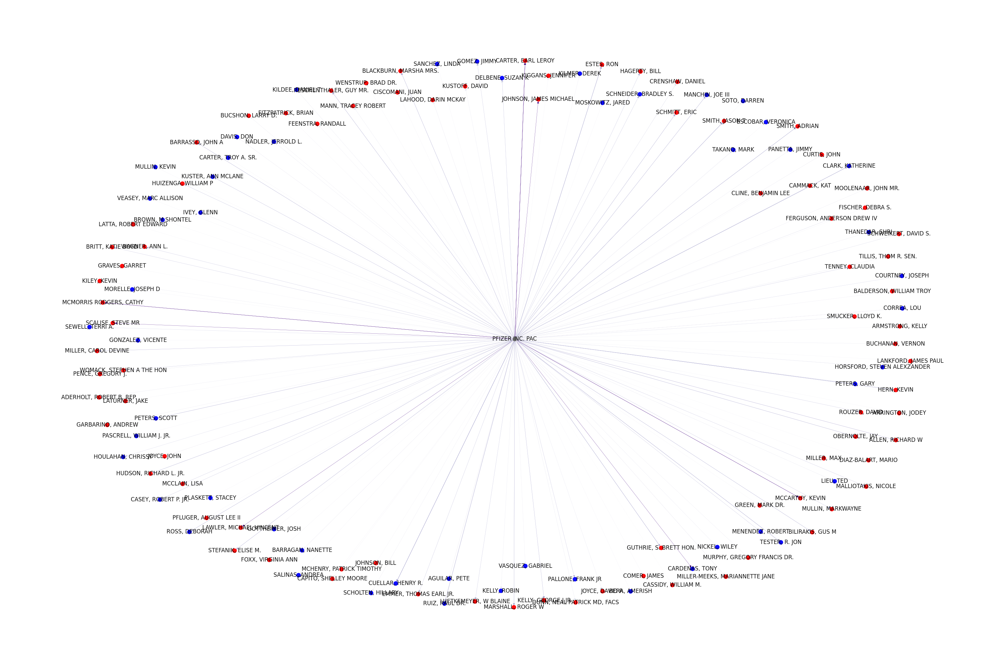

In [ ]:
pfizer = []
for edge in G.edges():
  if(edge[0] == "PFIZER INC. PAC"):
    pfizer.append(edge[1])
  if(edge[1] == "PFIZER INC. PAC"):
    pfizer.append(edge[0])
pfizer.append("PFIZER INC. PAC")

subGraph = G.subgraph(pfizer)
node_colors = [party_colors[subGraph.nodes[node]['party']] for node in subGraph.nodes()]
print(subGraph)

edge_weights = []
# ChatGPT helped me access the weight from an edge
edge_weights = [subGraph[u][v][0]['weight'] for u, v in subGraph.edges()]
print("Total Contributions: $", sum(edge_weights))

plt.figure(figsize=(30, 20))
pos = nx.spring_layout(subGraph, k=10)
nx.draw(subGraph, pos=pos, with_labels=True, font_size=12,
        node_color=node_colors, node_size=75, alpha=0.95,
        edge_color=edge_weights, width=0.3, edge_cmap=plt.cm.Purples)

This creates a dataframe of only the contibutions from one candidate to another candidate (not from PACS). 'P' is the FEC's designation of candidate committee.
I had to remove these two congresswoman from the dataset because of quirk in the reporting. It appears they set up a new committee or changed their name and transferred their funds to the new committee. This was much more than the contribution limit and was an outlier. Those two edges are a combined $337,715.

In [ ]:
can_to_can = data[data['CMTE_DSGN'] == 'P']
can_to_can = can_to_can[can_to_can['CMTE_NM'] != "LISA BLUNT ROCHESTER FOR CONGRESS"]
can_to_can = can_to_can[can_to_can['CMTE_NM'] != "LISA BLUNT ROCHESTER FOR SENATE"]
can_to_can = can_to_can[can_to_can['CMTE_NM'] != "BARBARA LEE FOR CONGRESS"]
can_to_can = can_to_can[can_to_can['CMTE_NM'] != "BARBARA LEE FOR U.S. SENATE"]

Creates a MultiDiGraph for only the candidates to other candidates dataframe. This graph only has 4887 edges compared to the original graph with 221877 edges. That is because most of the contributions come from PACs as opposed to other candidates.

In [ ]:
GCans = nx.MultiDiGraph()
for index, row in can_to_can.iterrows():
  from_node = row['CMTE_NM']
  to_node = row['NAME']
  weight = row['TRANSACTION_AMT']
  party = row['CAND_PTY_AFFILIATION']
  office = row['CAND_OFFICE']
  state = row['CAND_OFFICE_ST']

  GCans.add_node(from_node, party=party, office="From", state="From")
  GCans.add_node(to_node, party=party, office=office, state=state)
  GCans.add_edge(from_node, to_node, weight=weight)

print(GCans.number_of_edges())

4887


The denisty is still low because most candidates do not donate to other candidates.

In [ ]:
nx.density(GCans)

0.006787952530168678

This finds all the different party affiliations candidates may have. DEM, REP, and IND are the only ones who have sitting members of congress but others have candidates for federal offices which are represented in this dataset.

In [ ]:
data['CAND_PTY_AFFILIATION'].unique()

array(['REP', 'DEM', 'IND', 'DFL', 'UNK', 'PNP', 'IDP', 'NPA', 'NOP',
       'COM', 'W', 'NPP', 'GRE', 'NON'], dtype=object)

This creates a graph for all of the candidate to candidate contributions.Takes around 45 seconds to run. I also print out the total amount of money being contributed in the graph. 7 million dollars is represented in this graph. The graph contains 849 nodes or candidate with 4887 edges or contributions.

Total Contributions: $ 7084062
Edges:  4887
Nodes:  849
Density:  0.006787952530168678


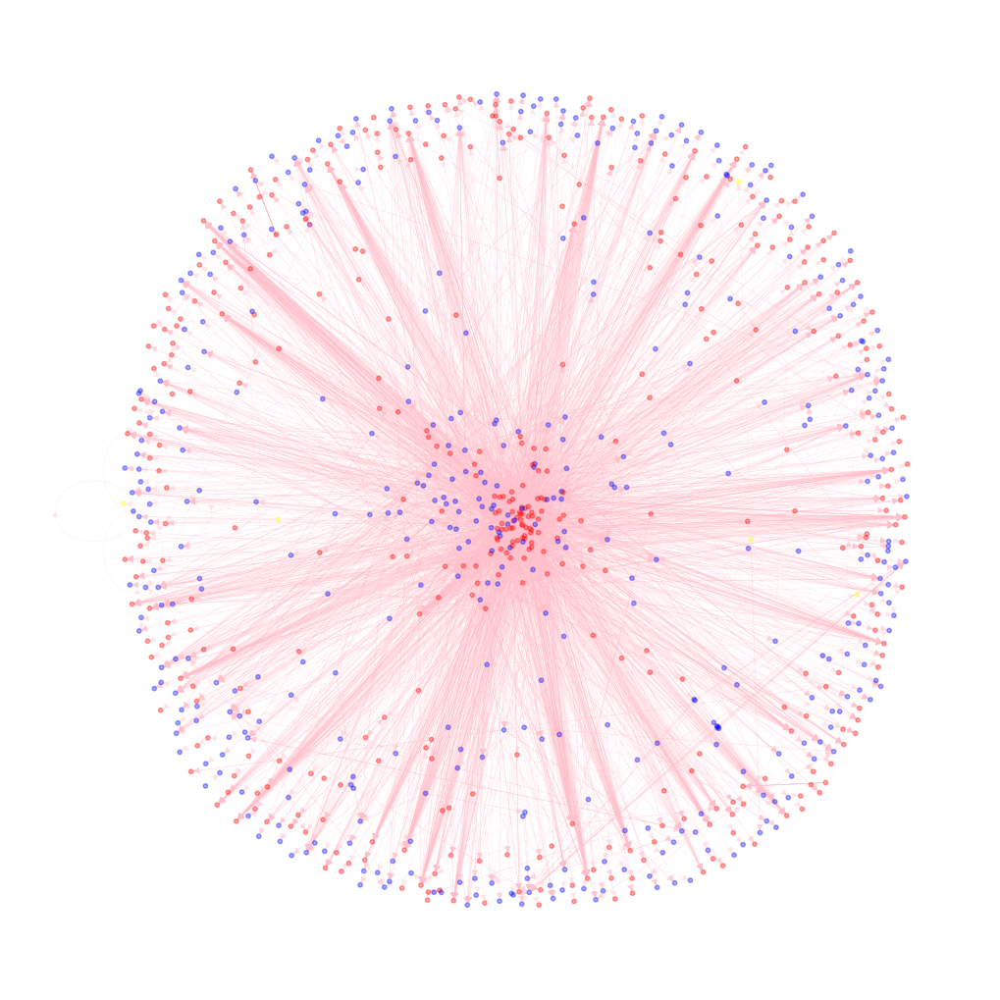

In [ ]:
edge_weights = [GCans[u][v][0]['weight'] for u, v in GCans.edges()]
#ChatGPT helped me add colors to the nodes
party_colors = {'DEM': 'blue', 'REP': 'red', 'IND': 'purple', 'GRE': 'green', 'DFL': 'yellow',
                'UNK': 'yellow', 'PNP': 'yellow', 'IDP': 'yellow', 'NPA': 'yellow',
                'NOP': 'yellow', 'COM': 'yellow', 'W': 'yellow', 'NPP': 'yellow', 'NON': 'yellow', 'From': 'grey'}
node_colors = [party_colors[GCans.nodes[node]['party']] for node in GCans.nodes()]

print("Total Contributions: $", sum(edge_weights))
print("Edges: ", GCans.number_of_edges())
print("Nodes: ", GCans.number_of_nodes())
print("Density: ", nx.density(GCans))

plt.figure(figsize=(10, 10))
pos = nx.spring_layout(GCans, k=1)

nx.draw(GCans, pos=pos, with_labels=False,
        node_color=node_colors, node_size=10, alpha=0.35,
        edge_color='pink', width=0.3)

These are the five highest degree centrality candidates. I think degree centrality makes the most sense for this data since many candidates are either contirbutors or receivers, there are not many that take in significant money while also sharing significant money. That makes the other centrality measures less important since things like shortest path and connectedness to other nodes are not necessarily going to indicate important nodes.


In [ ]:
degree_dict = nx.degree_centrality(GCans)
nx.set_node_attributes(GCans, degree_dict, 'degree')
from operator import itemgetter
sorted_degrees = sorted(degree_dict.items(), key=itemgetter(1), reverse=True)
print("Top 5 nodes by degrees:")
for b in sorted_degrees[:5]:
    print(b)

Top 5 nodes by degrees:
('SCALISE FOR CONGRESS', 0.1804245283018868)
('JEFFRIES FOR CONGRESS', 0.14504716981132074)
('TED LIEU FOR CONGRESS', 0.1356132075471698)
('LAWLER FOR CONGRESS', 0.11674528301886793)
('DR. BRIAN BABIN FOR CONGRESS', 0.11556603773584906)


All five of the candidates with the highest degree centrality are members of the House of Representatives. That makes sense since the Senate is much smaller with only 100 member and the House has 435 members. It makes sense that candidates would be much more likely to donate to a member in the same chamber.

Scalise has been the most consistent Republican leader in the House for the past couple years. He is the Majority leader and leaders frequently are big fund-raisers and tricke the money down to other caucus members. The same is true for Jeffries who is the Minority leader.

Ted Lieu is known as a popular Democrat on social media. I assume that he raises an exorbiant amount of money for his uncompetitive district and passes that money down to other candidates.

Mike Lawler won his race by less than 2000 votes in 2022. It makes sense that he would be on the receiving end of many donations since his race is so competitive.

Brian Babin appears to be a high powered fund raiser who has shared.

Function to create a network visualization of a member by passing in the candidate name. It does include edges not directly affiliated with them but of candidates who they donated or received from.

In [ ]:
def member(member):
  print(member, " network")
  member_net = []

  for edge in GCans.edges():
    if(edge[0] == member):
      member_net.append(edge[1])
    if(edge[1] == member):
      member_net.append(edge[0])


  member_net.append(member)
  subGraph = GCans.subgraph(member_net)

  node_colors = [party_colors[GCans.nodes[node]['party']] for node in subGraph.nodes()]
  edge_weights = [GCans[u][v][0]['weight'] for u, v in subGraph.edges()]

  plt.figure(figsize=(10, 10))
  pos = nx.spring_layout(subGraph, k=60)
  nx.draw(subGraph, pos=pos, with_labels=True, font_size=5,
          node_color=node_colors, node_size=10, alpha=0.5,
          edge_color=edge_weights, width=0.3, edge_cmap=plt.cm.Purples)

  node = pos[member]
  plt.plot(node[0], node[1], color='Black', marker='*')
  plt.text(node[0], node[1], member, size='larger')
  plt.show()

Displays the networks of the members with the five highest degrees. Function call is not great for data visaulization which usually requires tuning the attributes to make it more understandable. However, the function does allow for someone to take a quick glance at what is happening with a member, mainly if they are a giver or a taker.

SCALISE FOR CONGRESS  network


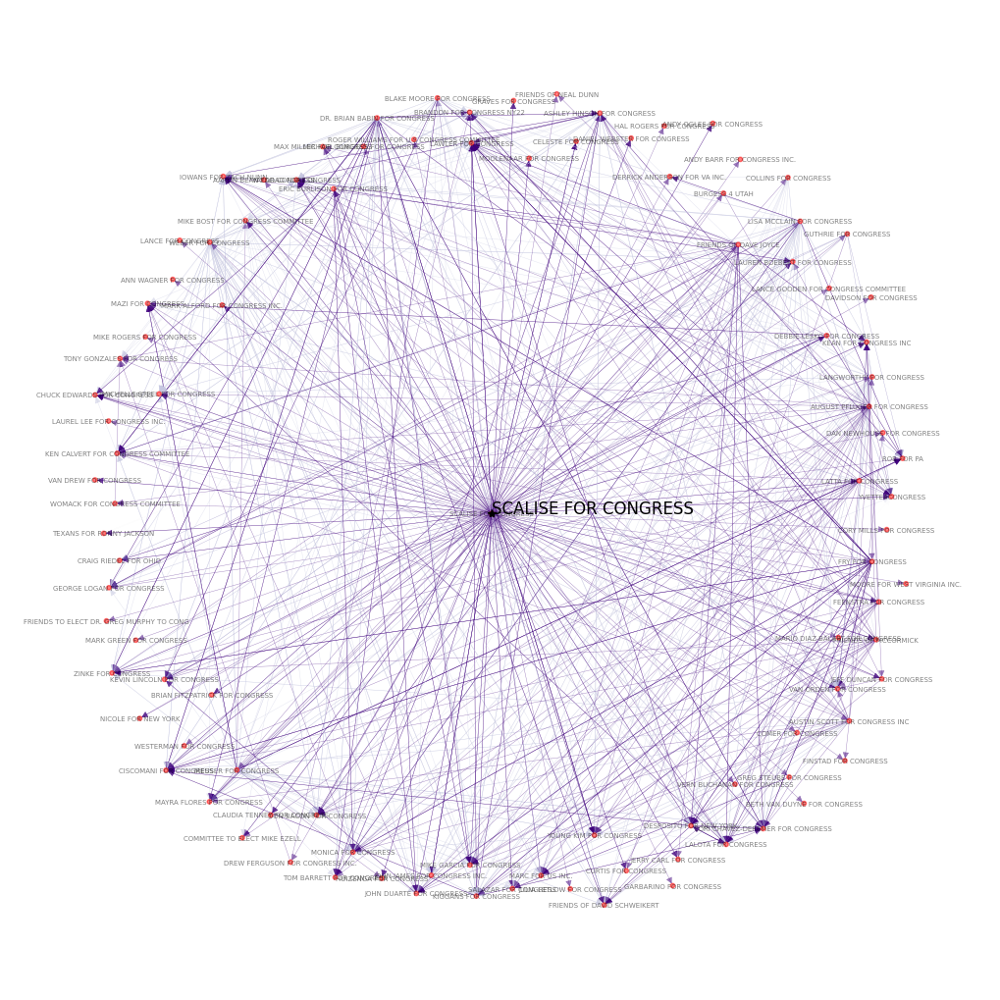

JEFFRIES FOR CONGRESS  network


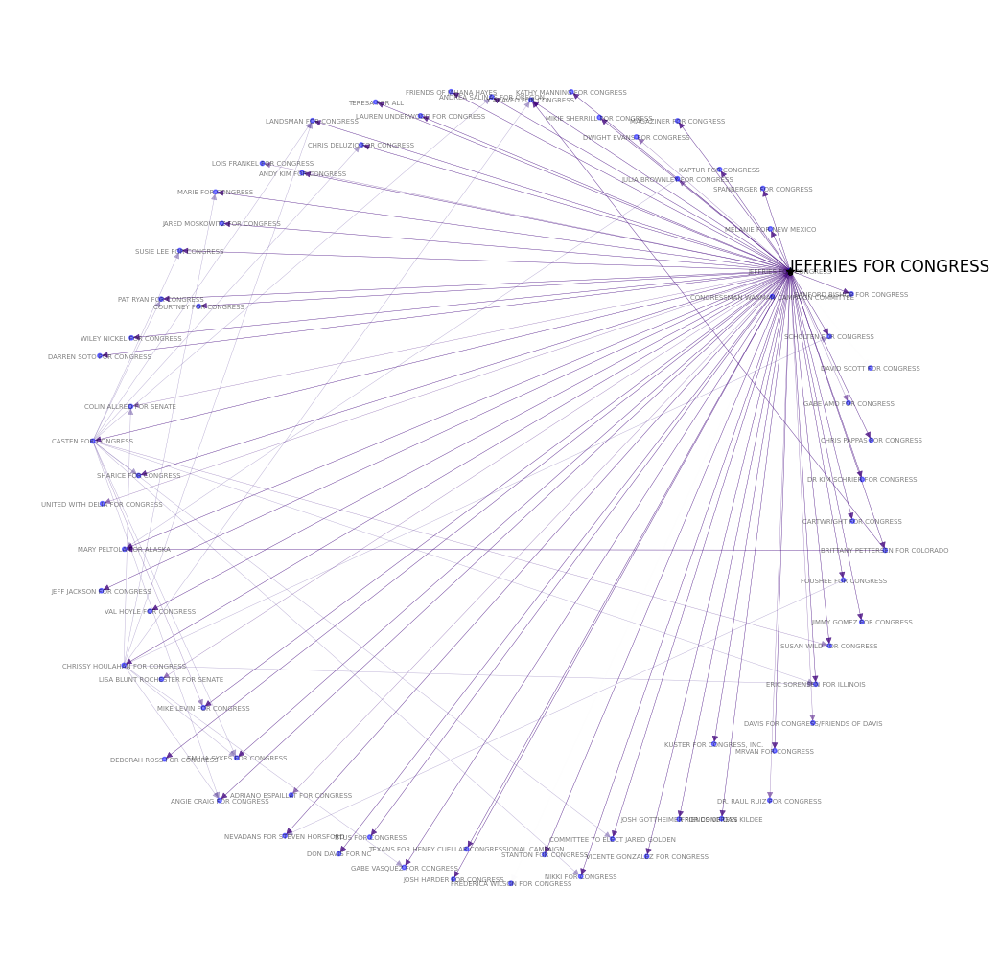

TED LIEU FOR CONGRESS  network


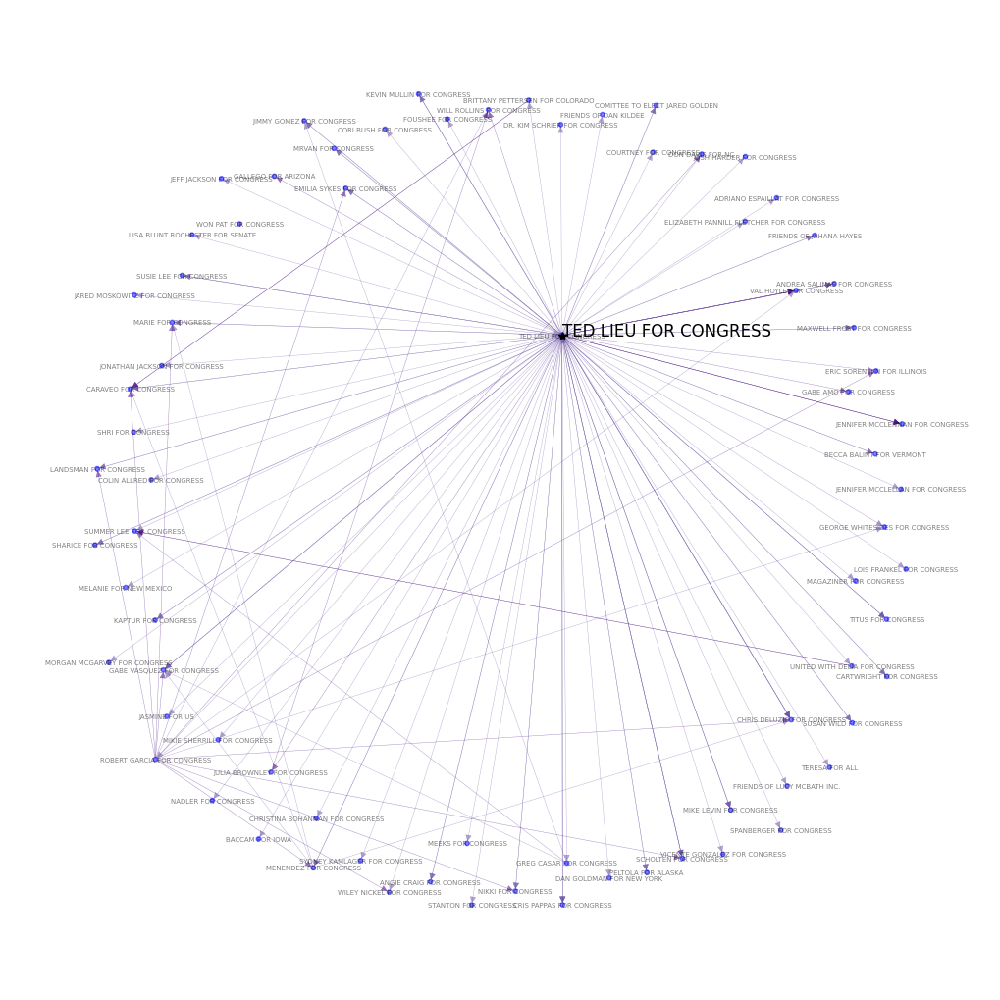

LAWLER FOR CONGRESS  network


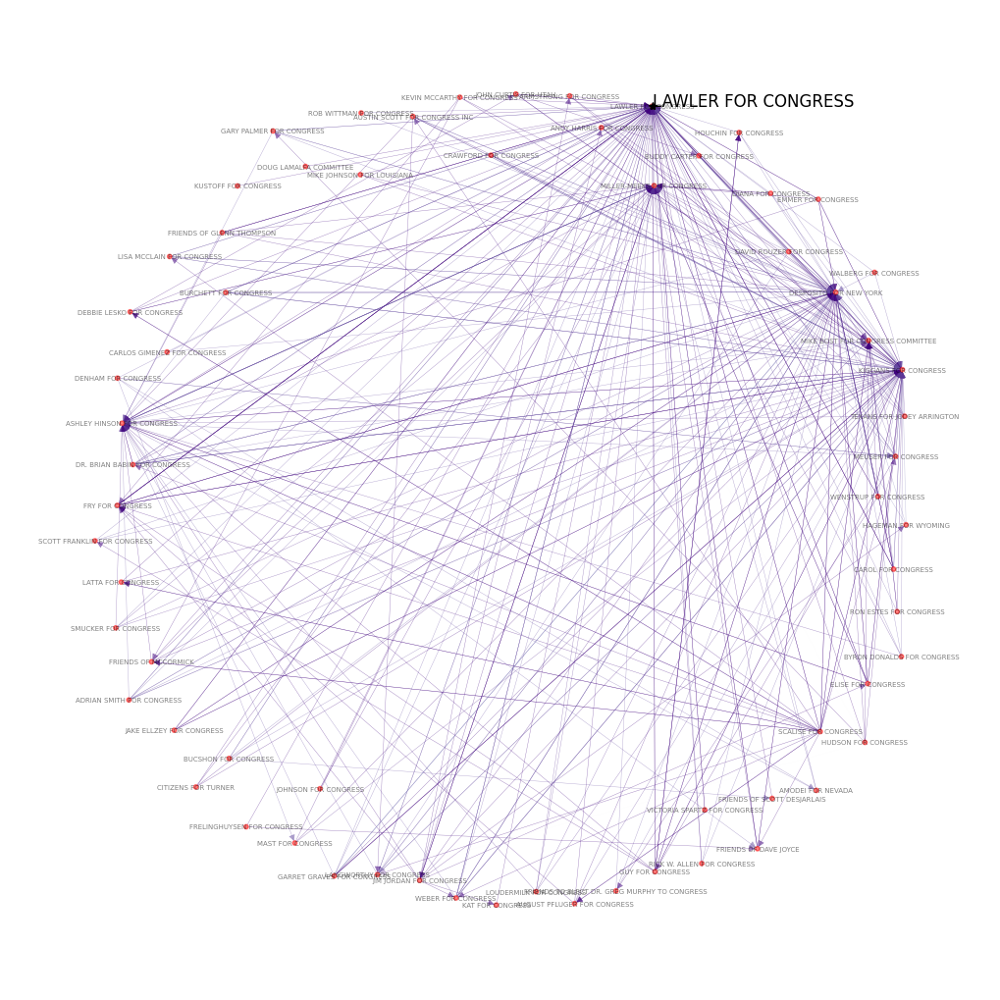

DR. BRIAN BABIN FOR CONGRESS  network


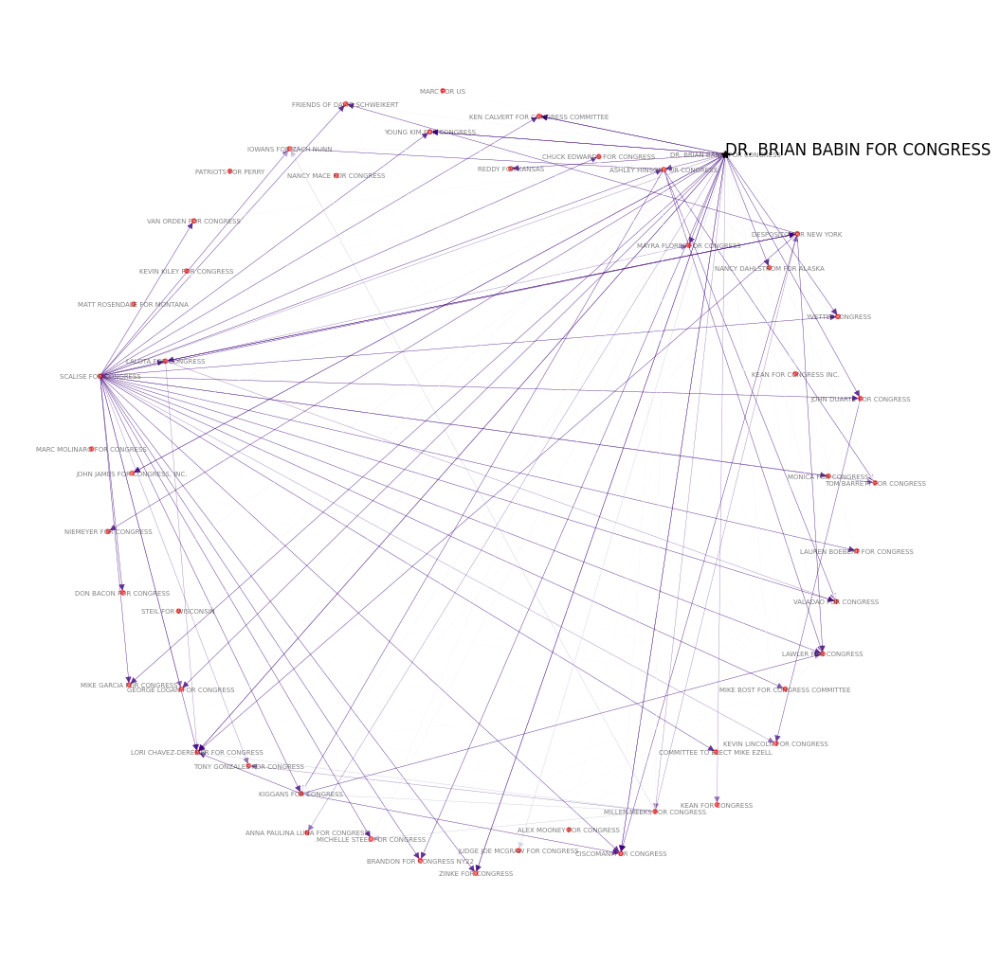

In [ ]:
member("SCALISE FOR CONGRESS")
member("JEFFRIES FOR CONGRESS")
member("TED LIEU FOR CONGRESS")
member("LAWLER FOR CONGRESS")
member("DR. BRIAN BABIN FOR CONGRESS")

Creates and displays the network for Democrats with all labels.


Total Contributions: $ 2142222.0
Edges:  1634
Nodes:  416
Density:  0.00946478220574606


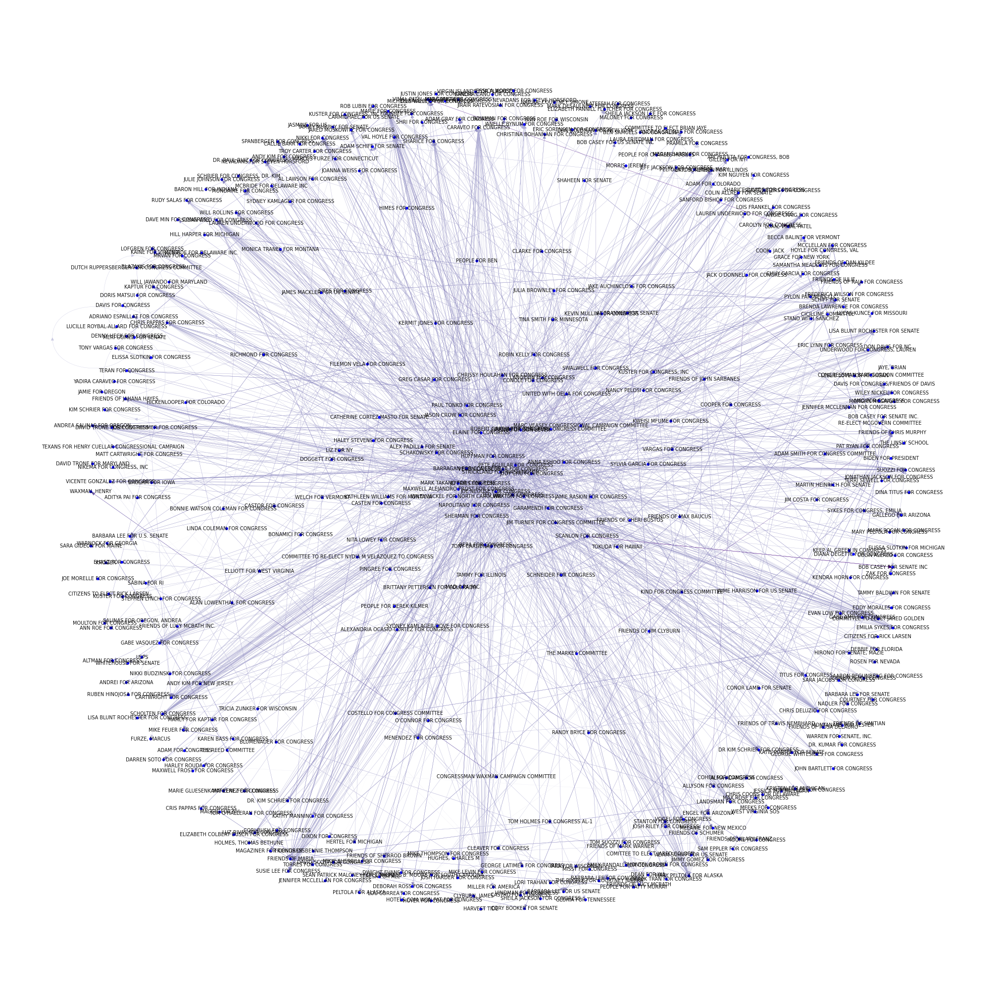

In [ ]:
dems = []
total_dems = 0.0;

for edge in GCans.edges():
    node1 = GCans.nodes[edge[0]]
    node2 = GCans.nodes[edge[1]]
    if GCans.nodes[edge[0]]['party'] == "DEM" and GCans.nodes[edge[1]]['party'] == "DEM":
        dems.append(edge[0])
        dems.append(edge[1])
        total_dems += GCans[edge[0]][edge[1]][0]['weight']


subGraph = GCans.subgraph(dems)


print("Total Contributions: $", total_dems)
print("Edges: ", subGraph.number_of_edges())
print("Nodes: ", subGraph.number_of_nodes())
print("Density: ", nx.density(subGraph))

node_colors = [party_colors[GCans.nodes[node]['party']] for node in subGraph.nodes()]
edge_weights = [GCans[u][v][0]['weight'] for u, v in subGraph.edges()]

plt.figure(figsize=(20, 20))
pos = nx.spring_layout(subGraph, k=8.3)
nx.draw(subGraph, pos=pos, with_labels=True, font_size=7,
        node_color=node_colors, node_size=10, alpha=0.95,
        edge_color=edge_weights, width=0.3, edge_cmap=plt.cm.Purples)


Finds degree and betweeness centrality for Democrats

In [ ]:
degree_dict = nx.degree_centrality(subGraph)
nx.set_node_attributes(subGraph, degree_dict, 'degree')
sorted_degree = sorted(degree_dict.items(), key=itemgetter(1), reverse=True)
print("Top 3 nodes by degree:")
for b in sorted_degree[:3]:
    print(b)
betweenness_dict = nx.betweenness_centrality(subGraph)
sorted_betweenness = sorted(betweenness_dict.items(), key=itemgetter(1), reverse=True)
print("Top 3 nodes by betweenness:")
for b in sorted_betweenness[:3]:
    print(b)

Top 3 nodes by degree:
('JEFFRIES FOR CONGRESS', 0.29638554216867474)
('TED LIEU FOR CONGRESS', 0.27710843373493976)
('PETE AGUILAR FOR CONGRESS', 0.21204819277108436)
Top 3 nodes by betweenness:
('TED LIEU FOR CONGRESS', 0.02839897893852844)
('JAMIE RASKIN FOR CONGRESS', 0.019239996563202428)
('SUSIE LEE FOR CONGRESS', 0.01842986854249295)


Quick function to highlight a node in the graph.

In [ ]:
def highlight_node(member):
  node = pos[member]
  plt.plot(node[0], node[1], color='Black', marker='*')
  plt.text(node[0], node[1], member, size='medium')


Graph of Democrats with highest degree members highlighted + Biden for President campaign.

Total Contributions: $ 2142222.0
Edges:  1634
Nodes:  416
Density:  0.00946478220574606


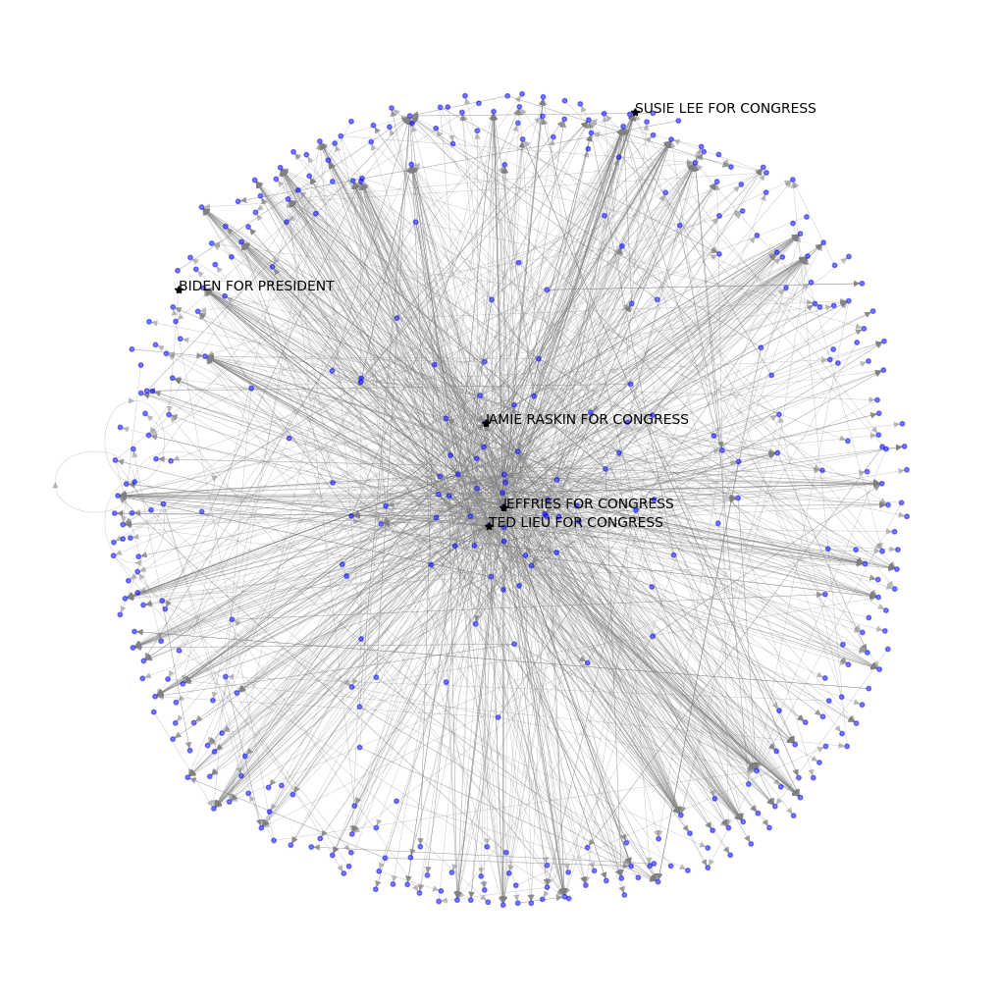

In [ ]:
dems = []
total_dems = 0.0;

for edge in GCans.edges():
    if GCans.nodes[edge[0]]['party'] == "DEM" and GCans.nodes[edge[1]]['party'] == "DEM":
        dems.append(edge[0])
        dems.append(edge[1])
        total_dems += GCans[edge[0]][edge[1]][0]['weight']

subGraph = GCans.subgraph(dems)

print("Total Contributions: $", total_dems)
print("Edges: ", subGraph.number_of_edges())
print("Nodes: ", subGraph.number_of_nodes())
print("Density: ", nx.density(subGraph))

node_colors = [party_colors[GCans.nodes[node]['party']] for node in subGraph.nodes()]
edge_weights = [GCans[u][v][0]['weight'] for u, v in subGraph.edges()]

fig = plt.figure(figsize=(10, 10))
pos = nx.spring_layout(subGraph, k=8.3)
nx.draw(subGraph, pos=pos, with_labels=False, font_size=5,
        node_color=node_colors, node_size=10, alpha=0.5,
        edge_color='gray', width=0.3)

highlight_node("JEFFRIES FOR CONGRESS")
fig.show()
highlight_node("TED LIEU FOR CONGRESS")
fig.show()
highlight_node("BIDEN FOR PRESIDENT")
fig.show()
highlight_node("JAMIE RASKIN FOR CONGRESS")
fig.show()
highlight_node("SUSIE LEE FOR CONGRESS")
fig.show()



I do the same for Republicans as I previously did with Democrats.

Total Contributions: $ 4933161.0
Edges:  3247
Nodes:  426
Density:  0.017934272300469484


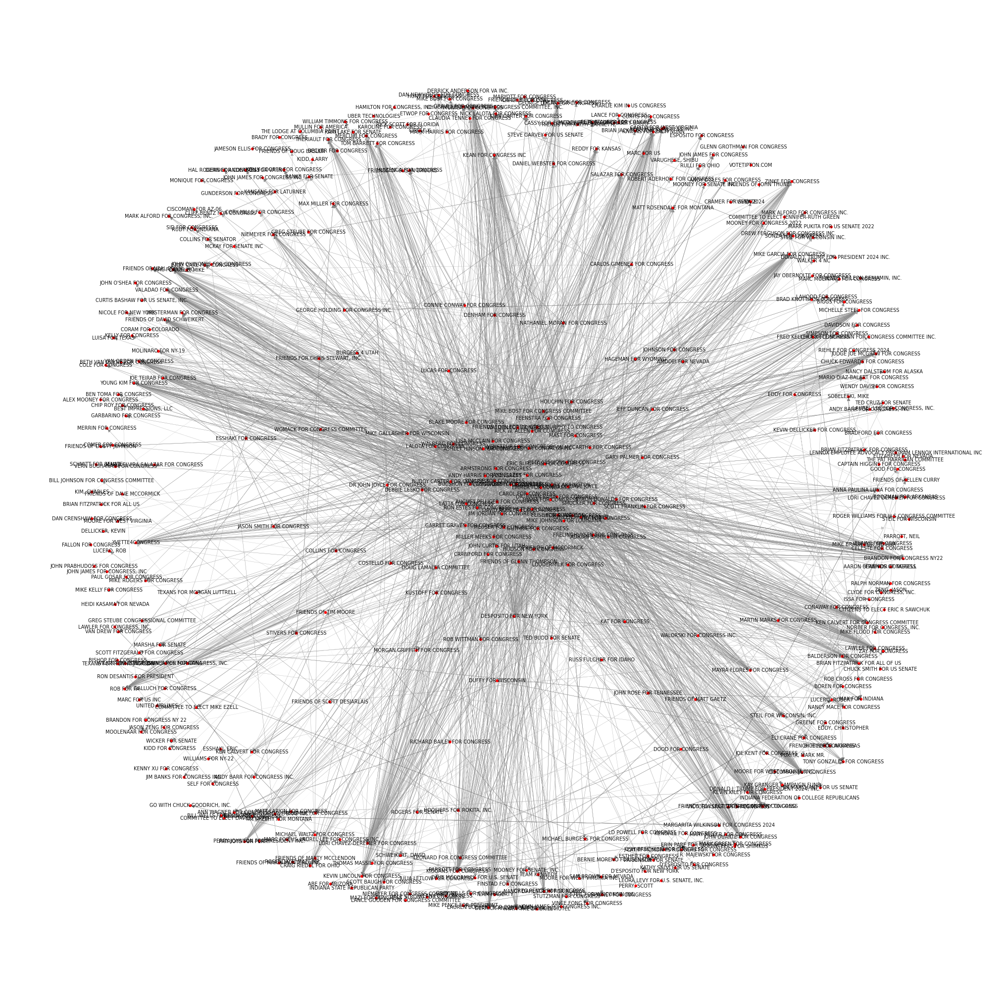

In [ ]:
repubs = []
total_reps = 0.0;

for edge in GCans.edges():
    if GCans.nodes[edge[0]]['party'] == "REP" and GCans.nodes[edge[1]]['party'] == "REP":
        repubs.append(edge[0])
        repubs.append(edge[1])
        total_reps += GCans[edge[0]][edge[1]][0]['weight']


subGraph = GCans.subgraph(repubs)

print("Total Contributions: $", total_reps)
print("Edges: ", subGraph.number_of_edges())
print("Nodes: ", subGraph.number_of_nodes())
print("Density: ", nx.density(subGraph))

node_colors = [party_colors[GCans.nodes[node]['party']] for node in subGraph.nodes()]
edge_weights = [GCans[u][v][0]['weight'] for u, v in subGraph.edges()]

plt.figure(figsize=(20, 20))
pos = nx.spring_layout(subGraph, k=9)
nx.draw(subGraph, pos=pos, with_labels=True, font_size=7,
        node_color=node_colors, node_size=10, alpha=0.95,
        edge_color=edge_weights, width=0.3, edge_cmap=plt.cm.Greys)

In [ ]:
degree_dict = nx.degree_centrality(subGraph)
nx.set_node_attributes(subGraph, degree_dict, 'degree')
sorted_degree = sorted(degree_dict.items(), key=itemgetter(1), reverse=True)
print("Top 3 nodes by degree:")
for b in sorted_degree[:3]:
    print(b)
betweenness_dict = nx.betweenness_centrality(subGraph)
sorted_betweenness = sorted(betweenness_dict.items(), key=itemgetter(1), reverse=True)
print("Top 3 nodes by betweenness:")
for b in sorted_betweenness[:3]:
    print(b)

Top 3 nodes by degree:
('SCALISE FOR CONGRESS', 0.36)
('LAWLER FOR CONGRESS', 0.2329411764705882)
('DR. BRIAN BABIN FOR CONGRESS', 0.23058823529411762)
Top 3 nodes by betweenness:
('MILLER-MEEKS FOR CONGRESS', 0.02653101712383067)
('JIM JORDAN FOR CONGRESS', 0.021512598435600654)
('ASHLEY HINSON FOR CONGRESS', 0.016001876222186986)


Total Contributions: $ 4933161.0
Edges:  3247
Nodes:  426
Density:  0.017934272300469484


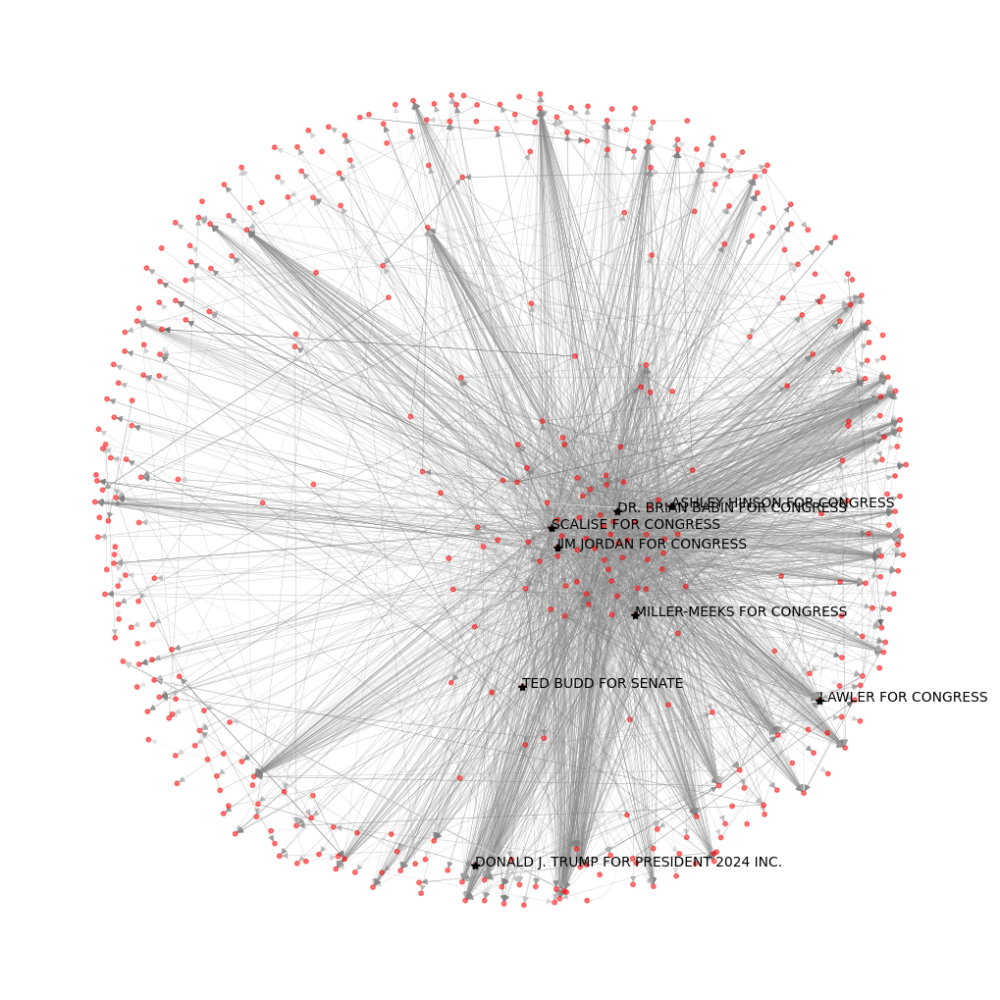

In [ ]:
repubs = []
total_reps = 0.0;

for edge in GCans.edges():
    if GCans.nodes[edge[0]]['party'] == "REP" and GCans.nodes[edge[1]]['party'] == "REP":
        repubs.append(edge[0])
        repubs.append(edge[1])
        total_reps += GCans[edge[0]][edge[1]][0]['weight']


subGraph = GCans.subgraph(repubs)

print("Total Contributions: $", total_reps)
print("Edges: ", subGraph.number_of_edges())
print("Nodes: ", subGraph.number_of_nodes())
print("Density: ", nx.density(subGraph))

node_colors = [party_colors[GCans.nodes[node]['party']] for node in subGraph.nodes()]
edge_weights = [GCans[u][v][0]['weight'] for u, v in subGraph.edges()]

plt.figure(figsize=(10, 10))
pos = nx.spring_layout(subGraph, k=9)
nx.draw(subGraph, pos=pos, with_labels=False,
        node_color=node_colors, node_size=10, alpha=0.5,
        edge_color=edge_weights, width=0.3, edge_cmap=plt.cm.Greys)

highlight_node("LAWLER FOR CONGRESS")
fig.show()
highlight_node("SCALISE FOR CONGRESS")
fig.show()
highlight_node("JIM JORDAN FOR CONGRESS")
fig.show()
highlight_node("MILLER-MEEKS FOR CONGRESS")
fig.show()
highlight_node("ASHLEY HINSON FOR CONGRESS")
fig.show()
highlight_node("DR. BRIAN BABIN FOR CONGRESS")
fig.show()
highlight_node("DONALD J. TRUMP FOR PRESIDENT 2024 INC.")
fig.show()
highlight_node("TED BUDD FOR SENATE")
fig.show()

Republicans overall have a much bigger graph in terms of monteary value being moved around edges between candidates compared to Democrats. There denisty is thus also larger, almost double.
The candidates with the highest degrees also have very well connected. Scalise is connected to 36% of other republicans with his centrality degree of 0.36.

These visualizations and analysis meet the rest of my goals for this project "The data is visualized to highlight patterns and features in the data. I am able to make conclusions about patterns in the data through empirical determination and visualization."


This is another visualization of Scalise's network since he is the most-connected candidate.

306000.0


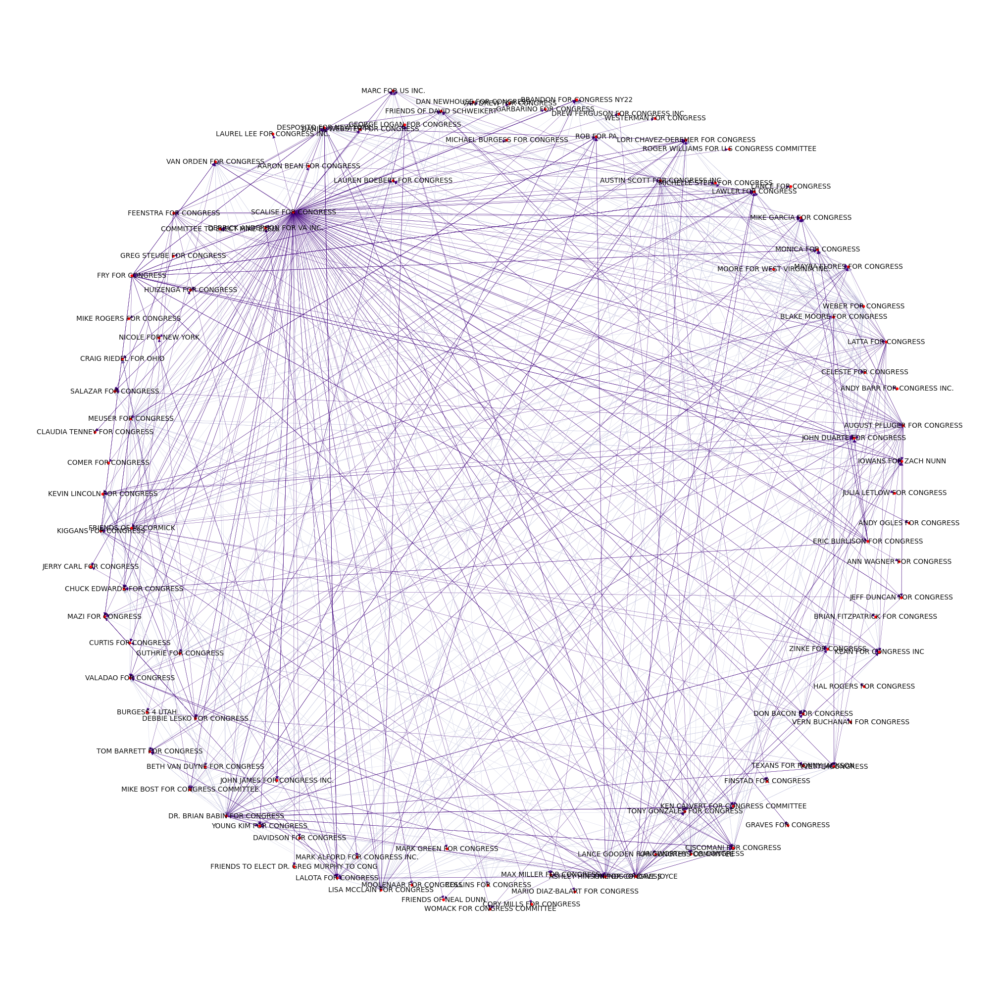

In [ ]:
scalise = []
total = 0.0
for edge in GCans.edges():
  if(edge[0] == "SCALISE FOR CONGRESS"):
    scalise.append(edge[1])
    total += GCans[edge[0]][edge[1]][0]['weight']
  if(edge[1] == "SCALISE FOR CONGRESS"):
    scalise.append(edge[0])


scalise.append("SCALISE FOR CONGRESS")
subGraph = GCans.subgraph(scalise)
print(total)

node_colors = [party_colors[GCans.nodes[node]['party']] for node in subGraph.nodes()]
edge_weights = [GCans[u][v][0]['weight'] for u, v in subGraph.edges()]

plt.figure(figsize=(20, 20))
pos = nx.spring_layout(subGraph, k=60)
nx.draw(subGraph, pos=pos, with_labels=True, font_size=10,
        node_color=node_colors, node_size=10, alpha=0.95,
        edge_color=edge_weights, width=0.3, edge_cmap=plt.cm.Purples)

This is a graph for contributions given or received by senate candidates. The Senate graph is much smaller than the House would be.

Total Contributions: $ 475965.0
Edges:  514
Nodes:  217
Density:  0.010966035159583547


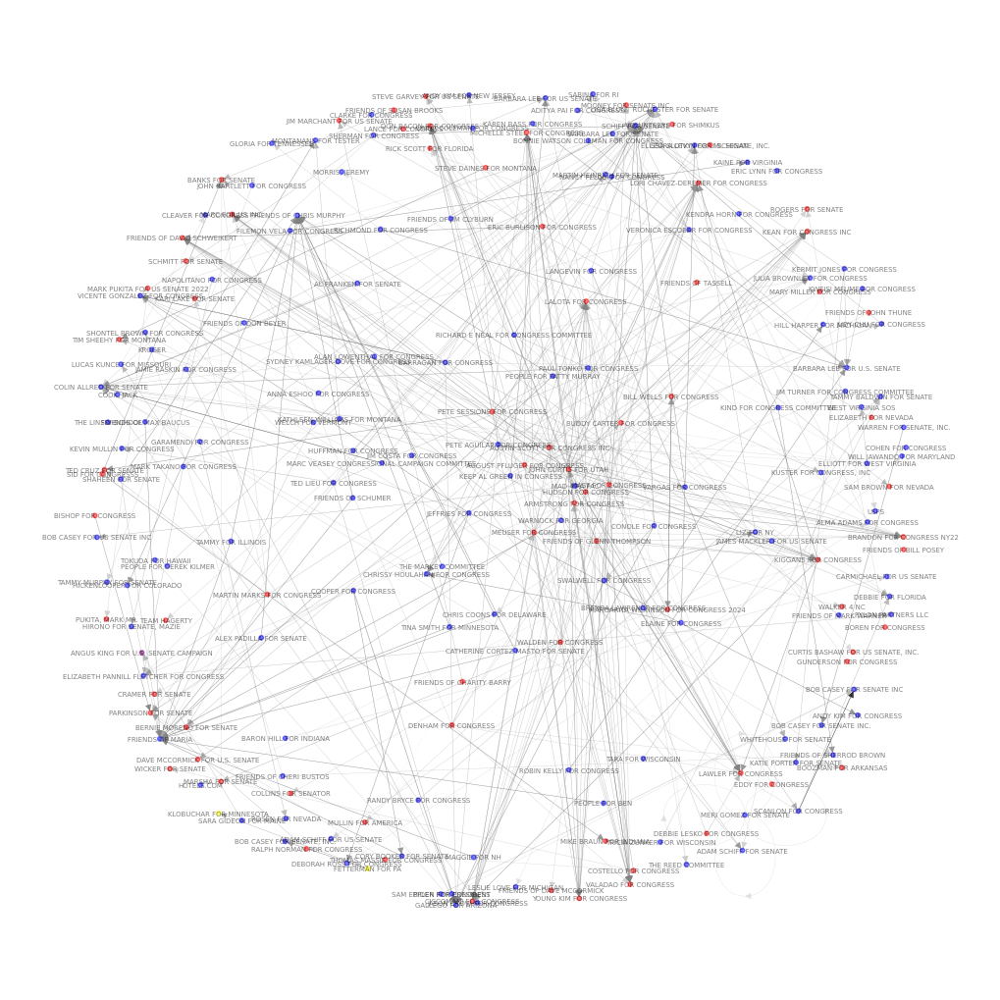

In [ ]:
senate = []
total_sen = 0.0;

for edge in GCans.edges():
    if GCans.nodes[edge[0]]['office'] == "S" or GCans.nodes[edge[1]]['office'] == "S":
        senate.append(edge[0])
        senate.append(edge[1])
        total_sen += GCans[edge[0]][edge[1]][0]['weight']


subGraph = GCans.subgraph(senate)

print("Total Contributions: $", total_sen)
print("Edges: ", subGraph.number_of_edges())
print("Nodes: ", subGraph.number_of_nodes())
print("Density: ", nx.density(subGraph))

node_colors = [party_colors[GCans.nodes[node]['party']] for node in subGraph.nodes()]
edge_weights = [GCans[u][v][0]['weight'] for u, v in subGraph.edges()]

plt.figure(figsize=(10, 10))
pos = nx.spring_layout(subGraph, k=9)
nx.draw(subGraph, pos=pos, with_labels=True, font_size=5,
        node_color=node_colors, node_size=10, alpha=0.5,
        edge_color=edge_weights, width=0.3, edge_cmap=plt.cm.Greys)

This is a subgraph for Alaska. The graph is centered around two candidates for congress, Peltola and Dahlstrom. It it expected to be a close race which is why both parties are supporting their candidate by sending money.

Total Contributions: $ 84614.0
Total Contributions to Mary Peltola: $ 43864.0
Total Contributions to Nancy Dahlstrom: $ 40750.0
Edges:  79
Nodes:  57
Density:  0.02474937343358396


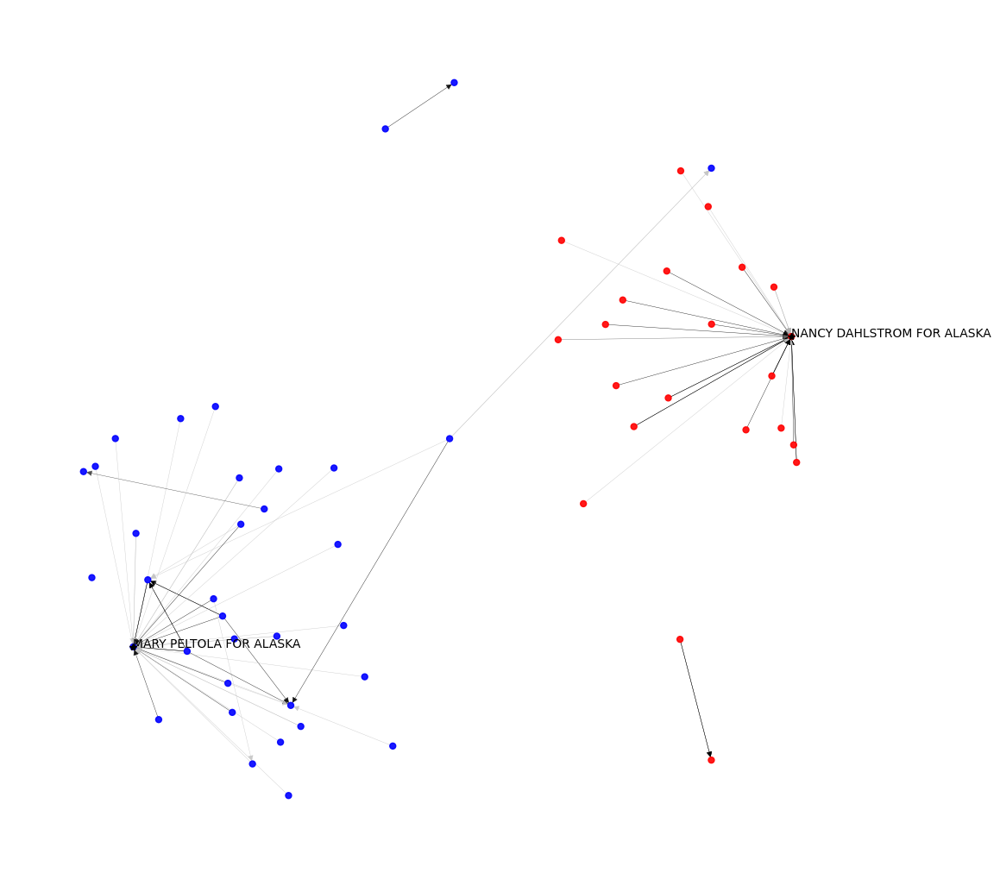

In [ ]:
ak = []
total_ak_race = 0.0;
total_peltola = 0.0
total_dahlstrom = 0.0

for edge in GCans.edges():
    if GCans.nodes[edge[0]]['state'] == "AK" or GCans.nodes[edge[1]]['state'] == "AK":
        ak.append(edge[0])
        ak.append(edge[1])
        #ChatGPT helped calculate the totals by using "in"
        if edge[1] in ["MARY PELTOLA FOR ALASKA", "NANCY DAHLSTROM FOR ALASKA"]:
          total_ak_race += GCans[edge[0]][edge[1]][0]['weight']
        if edge[1] == "MARY PELTOLA FOR ALASKA":
            total_peltola += GCans[edge[0]][edge[1]][0]['weight']
        elif edge[1] == "NANCY DAHLSTROM FOR ALASKA":
            total_dahlstrom += GCans[edge[0]][edge[1]][0]['weight']


subGraph = GCans.subgraph(ak)

print("Total Contributions: $", total_ak_race)
print("Total Contributions to Mary Peltola: $", total_peltola)
print("Total Contributions to Nancy Dahlstrom: $", total_dahlstrom)
print("Edges: ", subGraph.number_of_edges())
print("Nodes: ", subGraph.number_of_nodes())
print("Density: ", nx.density(subGraph))

node_colors = [party_colors[GCans.nodes[node]['party']] for node in subGraph.nodes()]
edge_weights = [GCans[u][v][0]['weight'] for u, v in subGraph.edges()]

fig = plt.figure(figsize=(10, 10))
pos = nx.spring_layout(subGraph, k=5)
nx.draw(subGraph, pos=pos, with_labels=False, font_size=7,
        node_color=node_colors, node_size=25, alpha=0.9,
        edge_color=edge_weights, width=0.3, edge_cmap=plt.cm.Greys)

highlight_node("MARY PELTOLA FOR ALASKA")
fig.show()
highlight_node("NANCY DAHLSTROM FOR ALASKA")


This is Pelosi's graph. She has given to 10 other candidates for a total of 20 thousand dollars.

20000.0


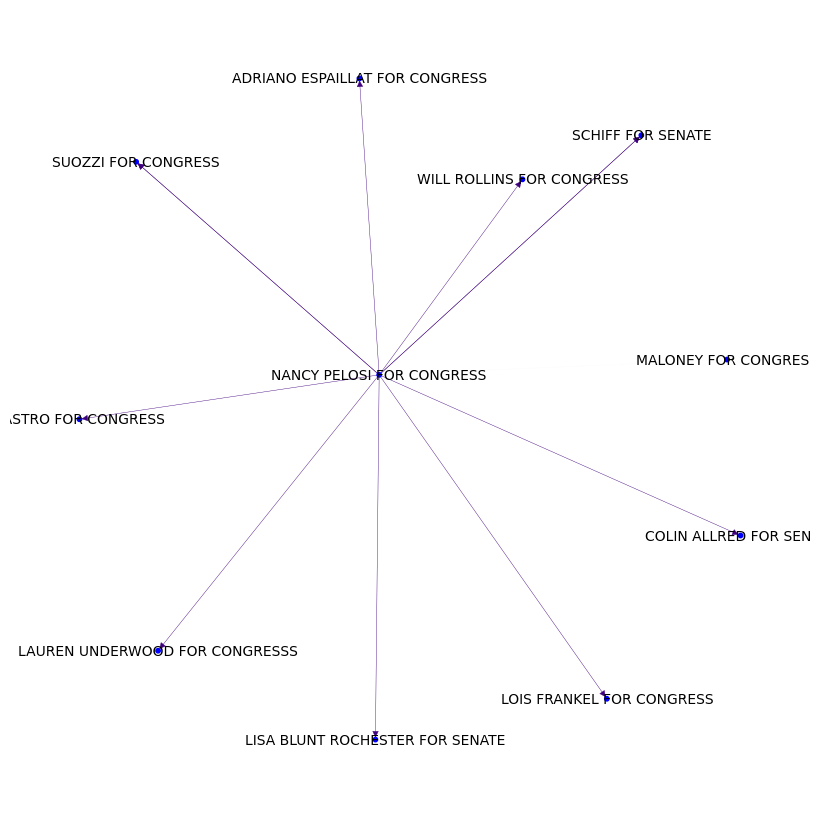

In [ ]:
pelosi = []
total = 0.0
for edge in GCans.edges():
  if(edge[0] == "NANCY PELOSI FOR CONGRESS"):
    pelosi.append(edge[1])
    total += GCans[edge[0]][edge[1]][0]['weight']
  if(edge[1] == "NANCY PELOSI FOR CONGRESS"):
    pelosi.append(edge[0])


pelosi.append("NANCY PELOSI FOR CONGRESS")
subGraph = GCans.subgraph(pelosi)
print(total)

node_colors = [party_colors[GCans.nodes[node]['party']] for node in subGraph.nodes()]
edge_weights = [GCans[u][v][0]['weight'] for u, v in subGraph.edges()]

plt.figure(figsize=(8, 8))
pos = nx.spring_layout(subGraph, k=4)
nx.draw(subGraph, pos=pos, with_labels=True, font_size=10,
        node_color=node_colors, node_size=10,
        edge_color=edge_weights, width=0.3, edge_cmap=plt.cm.Purples)

This is the independent graph. Sara Gideon ran a failed senate campaign that raised a ton of money and she did not spend all of it. This is a quirk in the dataset, candidates from old cycles who still have money sitting around. Al Franken who resigned in 2018 is also included in the dataset since he has donated to other candidates as well. Angus King is a democratically-aligned Senator who identifies as an independent.

Total Contributions: $ 2000.0
Edges:  1
Nodes:  2
Density:  0.5


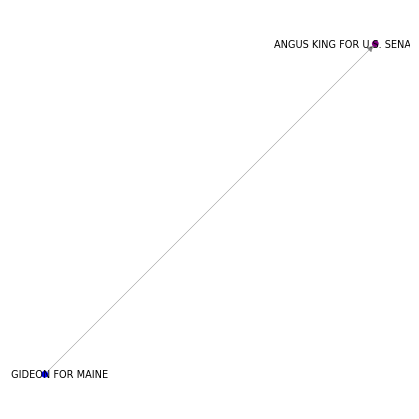

In [ ]:
inds = []
total_inds = 0.0;

for edge in GCans.edges():
    if GCans.nodes[edge[0]]['party'] == "IND" or GCans.nodes[edge[1]]['party'] == "IND":
        inds.append(edge[0])
        inds.append(edge[1])
        total_inds += GCans[edge[0]][edge[1]][0]['weight']

subGraph = GCans.subgraph(inds)

print("Total Contributions: $", total_inds)
print("Edges: ", subGraph.number_of_edges())
print("Nodes: ", subGraph.number_of_nodes())
print("Density: ", nx.density(subGraph))

node_colors = [party_colors[GCans.nodes[node]['party']] for node in subGraph.nodes()]
edge_weights = [GCans[u][v][0]['weight'] for u, v in subGraph.edges()]
''
fig = plt.figure(figsize=(4, 4))
pos = nx.spring_layout(subGraph, k=1)
nx.draw(subGraph, pos=pos, with_labels=True, font_size=7,
        node_color=node_colors, node_size=15, alpha=1,
        edge_color='gray', width=0.3)




I enjoyed learning about this particular dataset. I achieved all of my goals for this project. Loading the data in was not as tricky as expected but the data visualization required a lot of tuning up. I ran many more experiments throughout doing this but left in the most relevant findings.